In [1]:
# you will be prompted with a window asking to grant permissions
from google.colab import drive
drive.mount("/content/drive")

Mounted at /content/drive


In [2]:
# fill in the path in your Google Drive in the string below. Note: do not escape slashes or spaces
import os
datadir = "/content/assignment4_materials"
if not os.path.exists(datadir):
  !ln -s "/content/drive/My Drive/CS444/assignment4_materials/" $datadir # TODO: Fill your A3 path
os.chdir(datadir)
!pwd

/content/drive/My Drive/CS444/assignment4_materials


# Generative Adversarial Networks

For this part of the assignment you implement two different types of generative adversarial networks. We will train the networks on a dataset of cat face images.

In [6]:
import torch
from torch.utils.data import DataLoader
from torchvision import transforms
from torchvision.datasets import ImageFolder
import matplotlib.pyplot as plt
import numpy as np

%matplotlib inline
plt.rcParams['figure.figsize'] = (10.0, 8.0) # set default size of plots
plt.rcParams['image.interpolation'] = 'nearest'
plt.rcParams['image.cmap'] = 'gray'

%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [7]:
from gan.train import train

In [8]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "gpu")

# GAN loss functions

In this assignment you will implement two different types of GAN cost functions. You will first implement the loss from the [original GAN paper](https://arxiv.org/pdf/1406.2661.pdf). You will also implement the loss from [LS-GAN](https://arxiv.org/abs/1611.04076). 

### GAN loss

**TODO:** Implement the `discriminator_loss` and `generator_loss` functions in `gan/losses.py`.

The generator loss is given by:
$$\ell_G  =  -\mathbb{E}_{z \sim p(z)}\left[\log D(G(z))\right]$$
and the discriminator loss is:
$$ \ell_D = -\mathbb{E}_{x \sim p_\text{data}}\left[\log D(x)\right] - \mathbb{E}_{z \sim p(z)}\left[\log \left(1-D(G(z))\right)\right]$$
Note that these are negated from the equations presented earlier as we will be *minimizing* these losses.

**HINTS**: You should use the `torch.nn.functional.binary_cross_entropy_with_logits` function to compute the binary cross entropy loss since it is more numerically stable than using a softmax followed by BCE loss. The BCE loss is needed to compute the log probability of the true label given the logits output from the discriminator. Given a score $s\in\mathbb{R}$ and a label $y\in\{0, 1\}$, the binary cross entropy loss is

$$ bce(s, y) = -y * \log(s) - (1 - y) * \log(1 - s) $$


Instead of computing the expectation of $\log D(G(z))$, $\log D(x)$ and $\log \left(1-D(G(z))\right)$, we will be averaging over elements of the minibatch, so make sure to combine the loss by averaging instead of summing.

In [9]:
from gan.losses import discriminator_loss, generator_loss

### Least Squares GAN loss

**TODO:** Implement the `ls_discriminator_loss` and `ls_generator_loss` functions in `gan/losses.py`.

We'll now look at [Least Squares GAN](https://arxiv.org/abs/1611.04076), a newer, more stable alernative to the original GAN loss function. For this part, all we have to do is change the loss function and retrain the model. We'll implement equation (9) in the paper, with the generator loss:
$$\ell_G  =  \frac{1}{2}\mathbb{E}_{z \sim p(z)}\left[\left(D(G(z))-1\right)^2\right]$$
and the discriminator loss:
$$ \ell_D = \frac{1}{2}\mathbb{E}_{x \sim p_\text{data}}\left[\left(D(x)-1\right)^2\right] + \frac{1}{2}\mathbb{E}_{z \sim p(z)}\left[ \left(D(G(z))\right)^2\right]$$


**HINTS**: Instead of computing the expectation, we will be averaging over elements of the minibatch, so make sure to combine the loss by averaging instead of summing. When plugging in for $D(x)$ and $D(G(z))$ use the direct output from the discriminator (`scores_real` and `scores_fake`).

In [10]:
from gan.losses import ls_discriminator_loss, ls_generator_loss

# GAN model architecture

**TODO:** Implement the `Discriminator` and `Generator` networks in `gan/models.py`.

We recommend the following architectures which are inspired by [DCGAN](https://arxiv.org/pdf/1511.06434.pdf):

**Discriminator:**

- convolutional layer with in_channels=3, out_channels=128, kernel=4, stride=2
- convolutional layer with in_channels=128, out_channels=256, kernel=4, stride=2
- batch norm
- convolutional layer with in_channels=256, out_channels=512, kernel=4, stride=2
- batch norm
- convolutional layer with in_channels=512, out_channels=1024, kernel=4, stride=2
- batch norm
- convolutional layer with in_channels=1024, out_channels=1, kernel=4, stride=1

Use padding = 1 (not 0) for all the convolutional layers.

Instead of Relu we LeakyReLu throughout the discriminator (we use a negative slope value of 0.2). You can use simply use relu as well.

The output of your discriminator should be a single value score corresponding to each input sample. See `torch.nn.LeakyReLU`.


**Generator:**

**Note:** In the generator, you will need to use transposed convolution (sometimes known as fractionally-strided convolution or deconvolution). This function is implemented in pytorch as `torch.nn.ConvTranspose2d`.

- transpose convolution with in_channels=NOISE_DIM, out_channels=1024, kernel=4, stride=1
- batch norm
- transpose convolution with in_channels=1024, out_channels=512, kernel=4, stride=2
- batch norm
- transpose convolution with in_channels=512, out_channels=256, kernel=4, stride=2
- batch norm
- transpose convolution with in_channels=256, out_channels=128, kernel=4, stride=2
- batch norm
- transpose convolution with in_channels=128, out_channels=3, kernel=4, stride=2

The output of the final layer of the generator network should have a `tanh` nonlinearity to output values between -1 and 1. The output should be a 3x64x64 tensor for each sample (equal dimensions to the images from the dataset).





In [11]:
from gan.models import Discriminator, Generator

# Data loading

The cat images we provide are RGB images with a resolution of 64x64. In order to prevent our discriminator from overfitting, we will need to perform some data augmentation.

**TODO:** Implement data augmentation by adding new transforms to the cell below. At the minimum, you should have a RandomCrop and a ColorJitter, but we encourage you to experiment with different augmentations to see how the performance of the GAN changes. See https://pytorch.org/vision/stable/transforms.html.


In [12]:
batch_size = 32
imsize = 64
cat_root = './cats'

cat_train = ImageFolder(root=cat_root, transform=transforms.Compose([
  transforms.ToTensor(),
    
  # Example use of RandomCrop:
  transforms.Resize(int(1.15 * imsize)),
  transforms.RandomCrop(imsize),

  transforms.ColorJitter(brightness=(0,2),contrast=(0,2),saturation=(0,2)),
]))

cat_loader_train = DataLoader(cat_train, batch_size=batch_size, drop_last=True)

### Visualize dataset

/usr/local/lib/python3.9/dist-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works on Tensors - PIL will still use antialiasing). This also applies if you are using the inference transforms from the models weights: update the call to weights.transforms(antialias=True).
  warnings.warn(


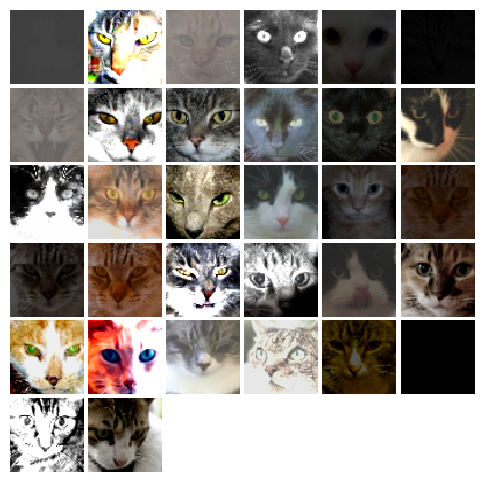

In [ ]:
from gan.utils import show_images

imgs = next(cat_loader_train.__iter__())[0].numpy().squeeze()
show_images(imgs, color=True)

# Training 


**TODO:** Fill in the training loop in `gan/train.py`.

In [ ]:
NOISE_DIM = 100
NUM_EPOCHS = 500
learning_rate = 0.001

### Train GAN

In [ ]:
D = Discriminator().to(device)
G = Generator(noise_dim=NOISE_DIM).to(device)

In [ ]:
D_optimizer = torch.optim.Adam(D.parameters(), lr=learning_rate, betas = (0.5, 0.999))
G_optimizer = torch.optim.Adam(G.parameters(), lr=learning_rate, betas = (0.5, 0.999))

In [ ]:
# original gan
train(D, G, D_optimizer, G_optimizer, discriminator_loss, 
          generator_loss, num_epochs=NUM_EPOCHS, show_every=250,
          batch_size=batch_size, train_loader=cat_loader_train, device=device)


Output hidden; open in https://colab.research.google.com to view.

### Train LS-GAN

In [ ]:
D = Discriminator().to(device)
G = Generator(noise_dim=NOISE_DIM).to(device)

In [ ]:
D_optimizer = torch.optim.Adam(D.parameters(), lr=learning_rate, betas = (0.5, 0.999))
G_optimizer = torch.optim.Adam(G.parameters(), lr=learning_rate, betas = (0.5, 0.999))

In [ ]:
# ls-gan
train(D, G, D_optimizer, G_optimizer, ls_discriminator_loss, 
          ls_generator_loss, num_epochs=NUM_EPOCHS, show_every=250,
          batch_size=batch_size, train_loader=cat_loader_train, device=device)

Output hidden; open in https://colab.research.google.com to view.

# Additional Data Loading - Abstract Dataset

In [13]:
batch_size = 32
imsize = 64
abstract_root = './abstract_data'

abstract_train = ImageFolder(root=abstract_root, transform=transforms.Compose([
  transforms.ToTensor(),

    # Example use of RandomCrop:
  transforms.Resize(int(1.15 * imsize)),
  transforms.RandomCrop(imsize),

  transforms.ColorJitter(brightness=(0,2),contrast=(0,2),saturation=(0,2)),

]))

abstract_loader_train = DataLoader(abstract_train, batch_size=batch_size, drop_last=True)


/usr/local/lib/python3.9/dist-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works on Tensors - PIL will still use antialiasing). This also applies if you are using the inference transforms from the models weights: update the call to weights.transforms(antialias=True).
  warnings.warn(


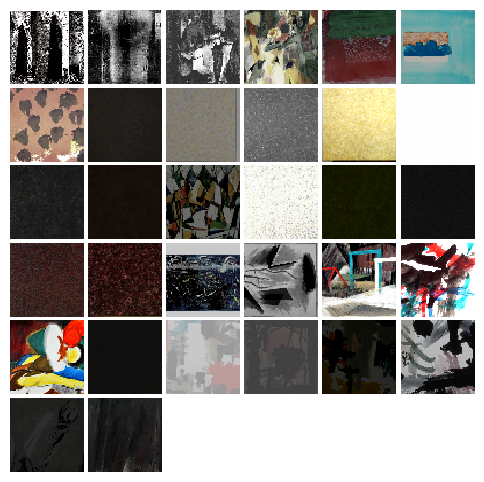

In [14]:
from gan.utils import show_images

imgs = next(abstract_loader_train.__iter__())[0].numpy().squeeze()
show_images(imgs, color=True)

# Training 


**TODO:** Fill in the training loop in `gan/train.py`.

In [15]:
NOISE_DIM = 100
NUM_EPOCHS = 300
learning_rate = 0.001

### Train GAN

In [ ]:
D = Discriminator().to(device)
G = Generator(noise_dim=NOISE_DIM).to(device)

In [ ]:
D_optimizer = torch.optim.Adam(D.parameters(), lr=learning_rate, betas = (0.5, 0.999))
G_optimizer = torch.optim.Adam(G.parameters(), lr=learning_rate, betas = (0.5, 0.999))

In [ ]:
# original gan
train(D, G, D_optimizer, G_optimizer, discriminator_loss, 
          generator_loss, num_epochs=NUM_EPOCHS, show_every=250,
          batch_size=batch_size, train_loader=abstract_loader_train, device=device)


Output hidden; open in https://colab.research.google.com to view.

### Train LS-GAN

In [16]:
D = Discriminator().to(device)
G = Generator(noise_dim=NOISE_DIM).to(device)

In [17]:
D_optimizer = torch.optim.Adam(D.parameters(), lr=learning_rate, betas = (0.5, 0.999))
G_optimizer = torch.optim.Adam(G.parameters(), lr=learning_rate, betas = (0.5, 0.999))

EPOCH:  1
Iter: 0, D: 0.551, G:27.16


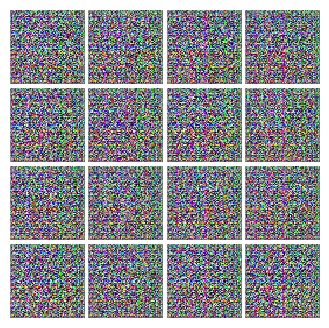


EPOCH:  2
EPOCH:  3
Iter: 250, D: 0.1696, G:0.2826


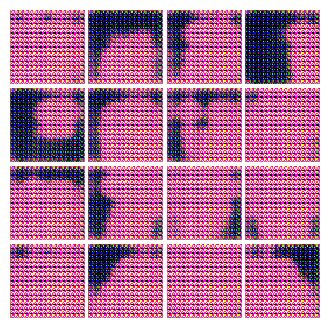


EPOCH:  4
EPOCH:  5
EPOCH:  6
Iter: 500, D: 0.1735, G:0.6885


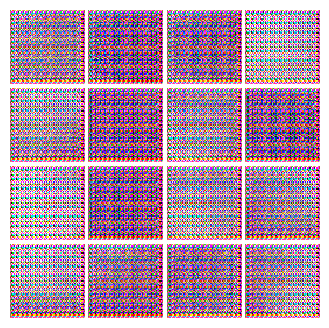


EPOCH:  7
EPOCH:  8
EPOCH:  9
Iter: 750, D: 0.2233, G:0.238


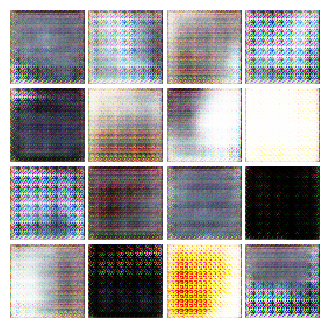


EPOCH:  10
EPOCH:  11
EPOCH:  12
Iter: 1000, D: 0.3356, G:0.3272


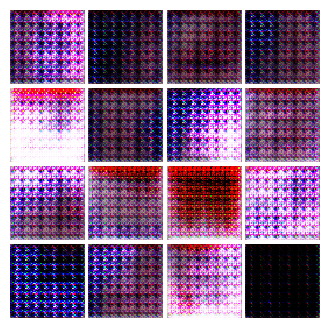


EPOCH:  13
EPOCH:  14
EPOCH:  15
Iter: 1250, D: 0.325, G:0.4889


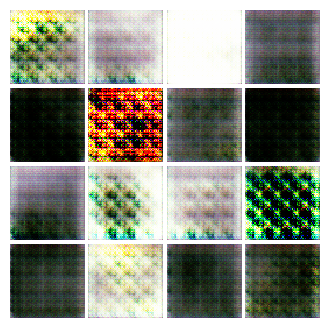


EPOCH:  16
EPOCH:  17
EPOCH:  18
Iter: 1500, D: 0.279, G:0.2373


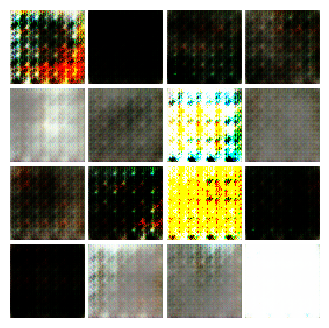


EPOCH:  19
EPOCH:  20
EPOCH:  21
Iter: 1750, D: 0.1899, G:0.1972


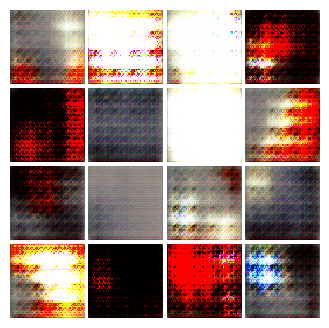


EPOCH:  22
EPOCH:  23
EPOCH:  24
Iter: 2000, D: 0.3187, G:0.1501


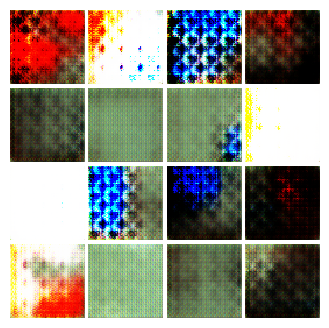


EPOCH:  25
EPOCH:  26
EPOCH:  27
Iter: 2250, D: 0.1435, G:0.3239


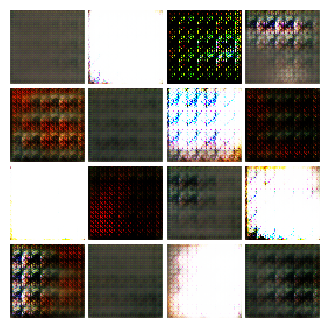


EPOCH:  28
EPOCH:  29
EPOCH:  30
Iter: 2500, D: 0.4057, G:0.3607


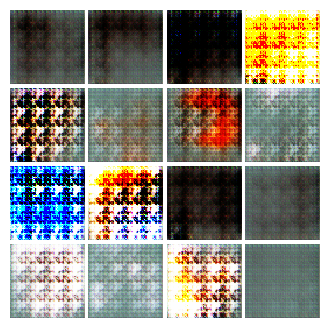


EPOCH:  31
EPOCH:  32
Iter: 2750, D: 0.1563, G:0.2638


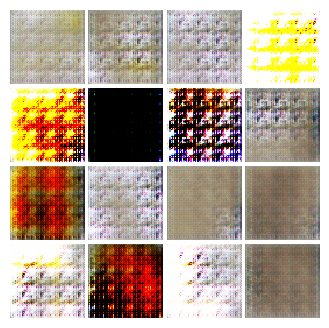


EPOCH:  33
EPOCH:  34
EPOCH:  35
Iter: 3000, D: 0.1627, G:0.2854


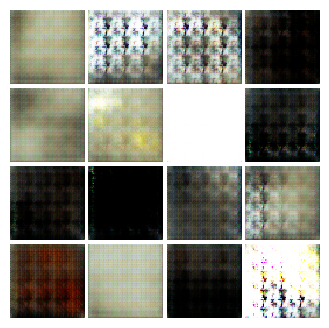


EPOCH:  36
EPOCH:  37
EPOCH:  38
Iter: 3250, D: 0.1671, G:0.3969


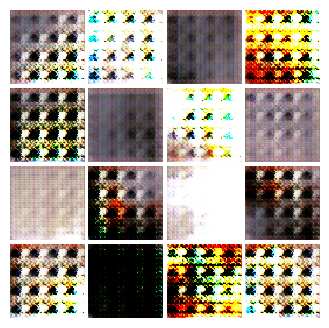


EPOCH:  39
EPOCH:  40
EPOCH:  41
Iter: 3500, D: 0.2217, G:0.1366


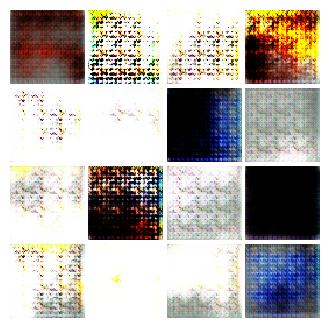


EPOCH:  42
EPOCH:  43
EPOCH:  44
Iter: 3750, D: 0.2262, G:0.1758


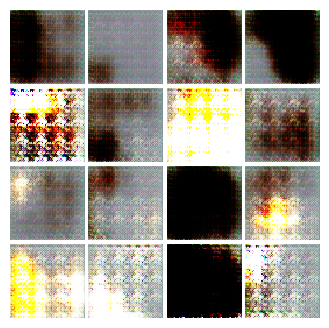


EPOCH:  45
EPOCH:  46
EPOCH:  47
Iter: 4000, D: 0.2509, G:0.3734


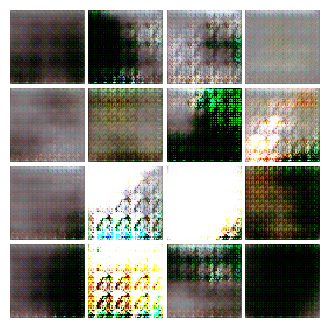


EPOCH:  48
EPOCH:  49
EPOCH:  50
Iter: 4250, D: 0.3535, G:0.3183


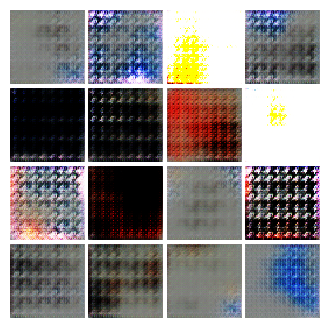


EPOCH:  51
EPOCH:  52
EPOCH:  53
Iter: 4500, D: 0.1068, G:0.4606


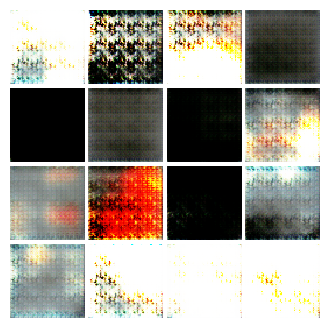


EPOCH:  54
EPOCH:  55
EPOCH:  56
Iter: 4750, D: 0.1841, G:0.5666


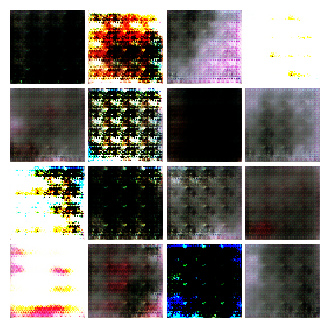


EPOCH:  57
EPOCH:  58
EPOCH:  59
Iter: 5000, D: 0.2004, G:0.2844


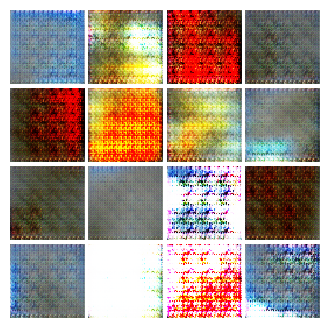


EPOCH:  60
EPOCH:  61
EPOCH:  62
Iter: 5250, D: 0.3071, G:0.312


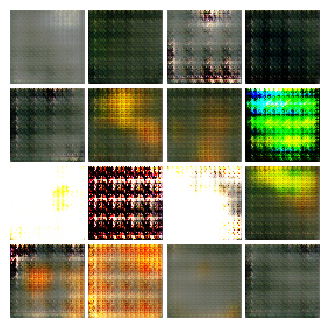


EPOCH:  63
EPOCH:  64
Iter: 5500, D: 0.1392, G:0.2221


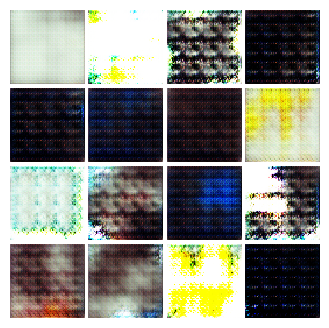


EPOCH:  65
EPOCH:  66
EPOCH:  67
Iter: 5750, D: 0.293, G:0.1527


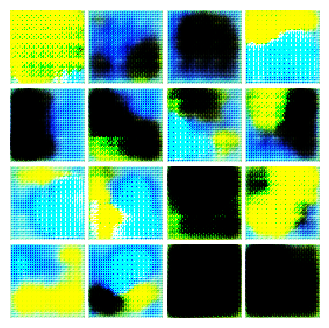


EPOCH:  68
EPOCH:  69
EPOCH:  70
Iter: 6000, D: 0.2702, G:0.1871


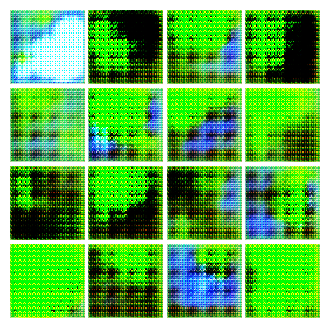


EPOCH:  71
EPOCH:  72
EPOCH:  73
Iter: 6250, D: 0.1172, G:0.263


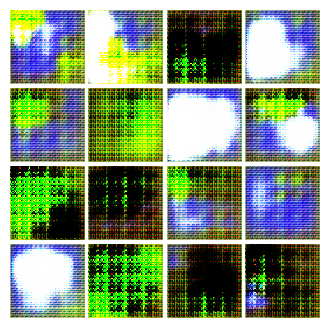


EPOCH:  74
EPOCH:  75
EPOCH:  76
Iter: 6500, D: 0.1799, G:0.2388


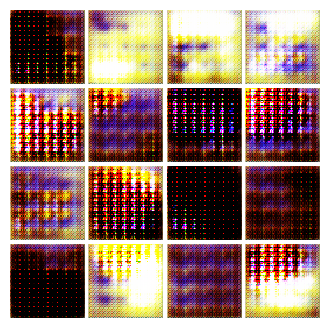


EPOCH:  77
EPOCH:  78
EPOCH:  79
Iter: 6750, D: 0.24, G:0.1464


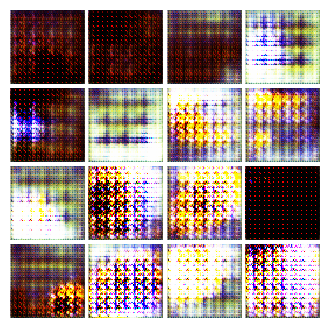


EPOCH:  80
EPOCH:  81
EPOCH:  82
Iter: 7000, D: 0.2982, G:0.2578


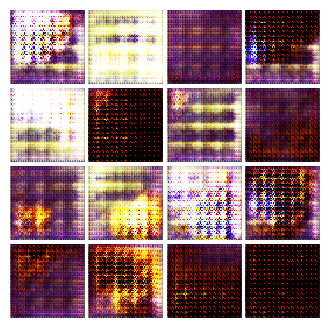


EPOCH:  83
EPOCH:  84
EPOCH:  85
Iter: 7250, D: 0.275, G:0.1423


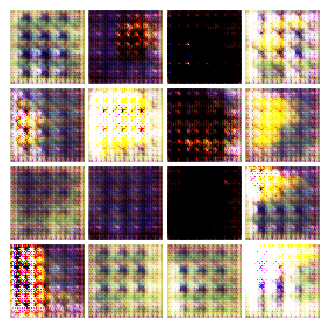


EPOCH:  86
EPOCH:  87
EPOCH:  88
Iter: 7500, D: 0.2494, G:0.1425


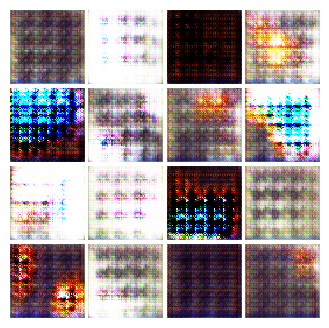


EPOCH:  89
EPOCH:  90
EPOCH:  91
Iter: 7750, D: 0.2688, G:0.1318


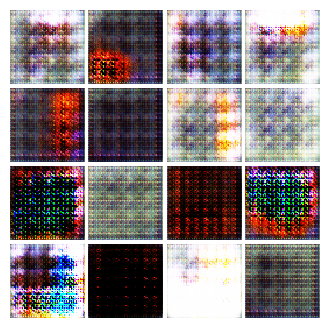


EPOCH:  92
EPOCH:  93
EPOCH:  94
Iter: 8000, D: 0.2531, G:0.1413


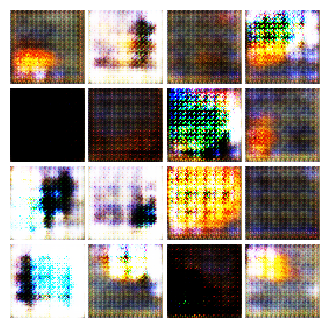


EPOCH:  95
EPOCH:  96
Iter: 8250, D: 0.5625, G:0.2226


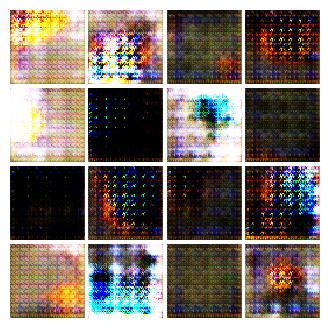


EPOCH:  97
EPOCH:  98
EPOCH:  99
Iter: 8500, D: 0.2985, G:0.1276


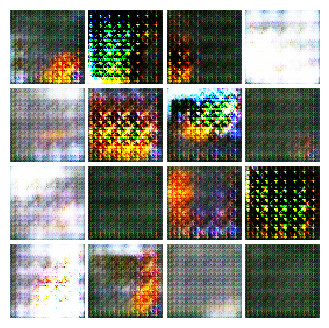


EPOCH:  100
EPOCH:  101
EPOCH:  102
Iter: 8750, D: 0.2647, G:0.1422


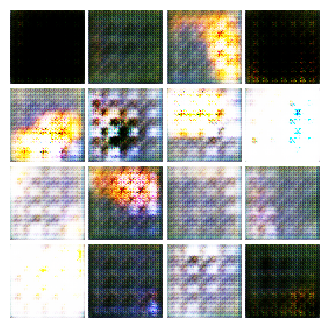


EPOCH:  103
EPOCH:  104
EPOCH:  105
Iter: 9000, D: 0.2555, G:0.1396


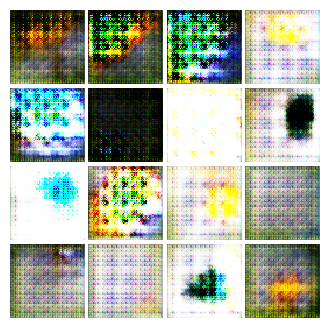


EPOCH:  106
EPOCH:  107
EPOCH:  108
Iter: 9250, D: 0.3054, G:0.172


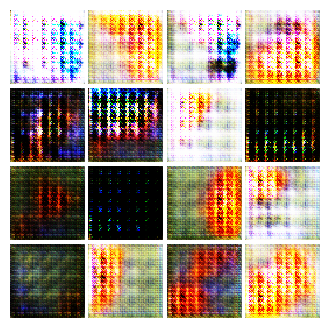


EPOCH:  109
EPOCH:  110
EPOCH:  111
Iter: 9500, D: 0.2319, G:0.142


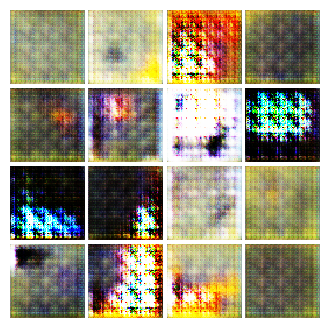


EPOCH:  112
EPOCH:  113
EPOCH:  114
Iter: 9750, D: 0.26, G:0.1662


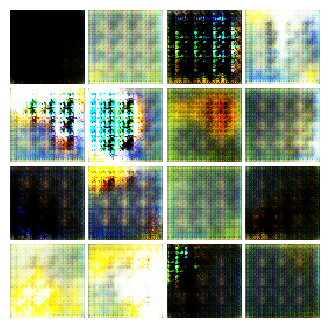


EPOCH:  115
EPOCH:  116
EPOCH:  117
Iter: 10000, D: 0.2773, G:0.1638


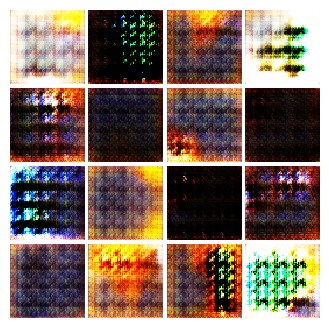


EPOCH:  118
EPOCH:  119
EPOCH:  120
Iter: 10250, D: 0.2184, G:0.1308


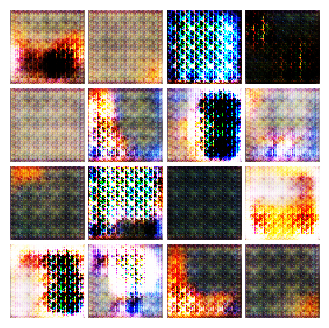


EPOCH:  121
EPOCH:  122
EPOCH:  123
Iter: 10500, D: 0.2998, G:0.1351


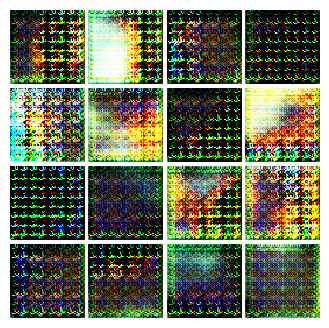


EPOCH:  124
EPOCH:  125
EPOCH:  126
Iter: 10750, D: 0.3262, G:0.1908


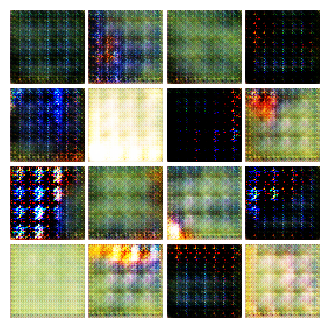


EPOCH:  127
EPOCH:  128
Iter: 11000, D: 0.2455, G:0.1394


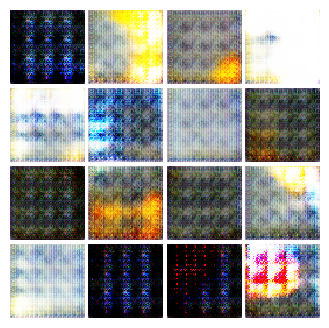


EPOCH:  129
EPOCH:  130
EPOCH:  131
Iter: 11250, D: 0.2769, G:0.1482


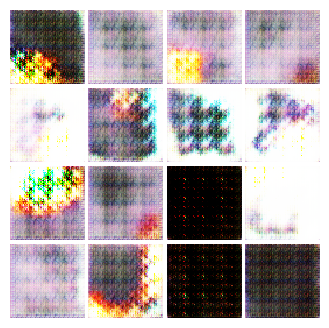


EPOCH:  132
EPOCH:  133
EPOCH:  134
Iter: 11500, D: 0.2549, G:0.148


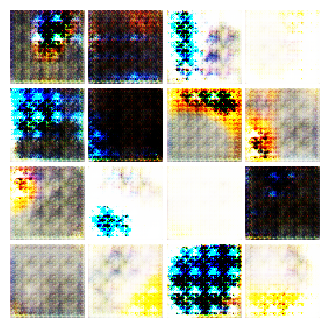


EPOCH:  135
EPOCH:  136
EPOCH:  137
Iter: 11750, D: 0.2697, G:0.1842


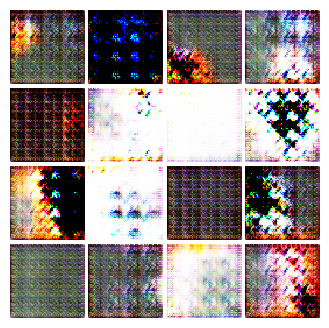


EPOCH:  138
EPOCH:  139
EPOCH:  140
Iter: 12000, D: 0.2211, G:0.1439


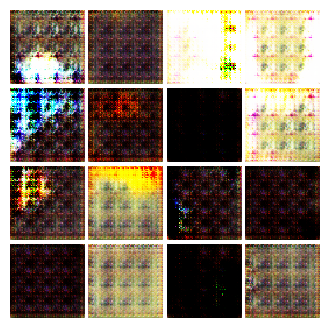


EPOCH:  141
EPOCH:  142
EPOCH:  143
Iter: 12250, D: 0.2213, G:0.1522


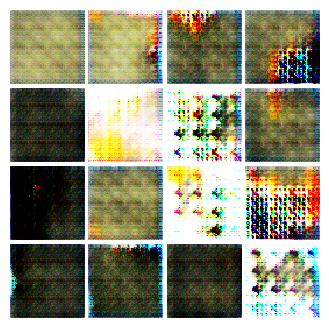


EPOCH:  144
EPOCH:  145
EPOCH:  146
Iter: 12500, D: 0.2363, G:0.1996


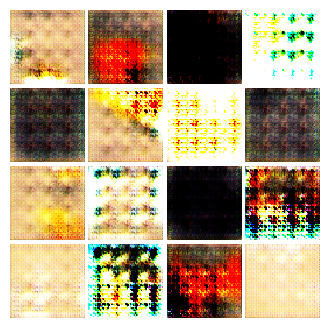


EPOCH:  147
EPOCH:  148
EPOCH:  149
Iter: 12750, D: 0.2863, G:0.1172


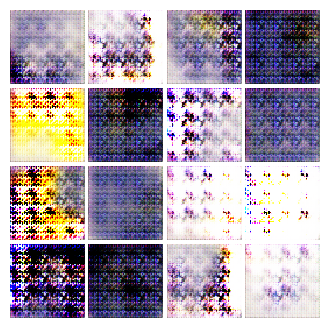


EPOCH:  150
EPOCH:  151
EPOCH:  152
Iter: 13000, D: 0.2276, G:0.2061


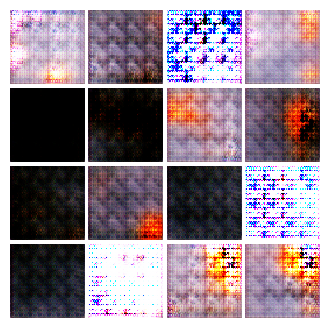


EPOCH:  153
EPOCH:  154
EPOCH:  155
Iter: 13250, D: 0.3158, G:0.2091


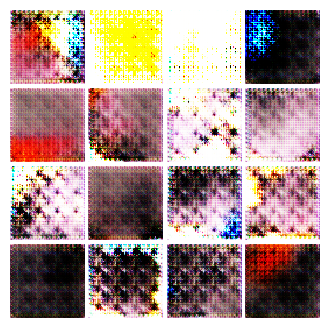


EPOCH:  156
EPOCH:  157
Iter: 13500, D: 0.2887, G:0.2356


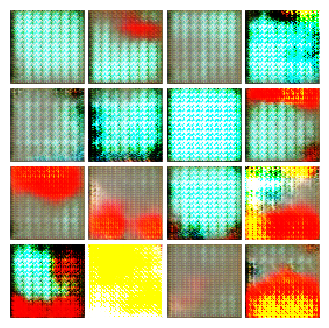


EPOCH:  158
EPOCH:  159
EPOCH:  160
Iter: 13750, D: 0.2302, G:0.1938


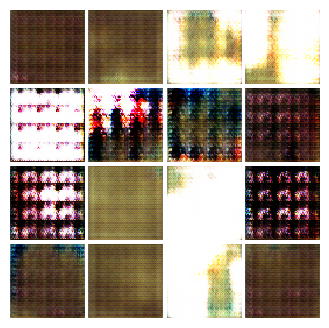


EPOCH:  161
EPOCH:  162
EPOCH:  163
Iter: 14000, D: 0.2706, G:0.1301


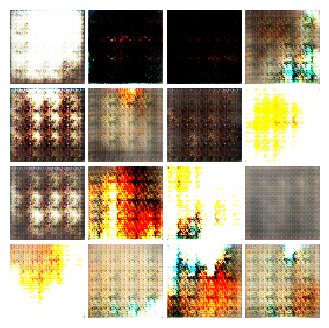


EPOCH:  164
EPOCH:  165
EPOCH:  166
Iter: 14250, D: 0.2529, G:0.3672


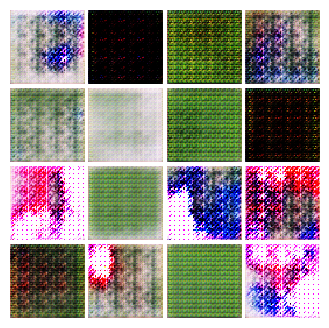


EPOCH:  167
EPOCH:  168
EPOCH:  169
Iter: 14500, D: 0.2601, G:0.141


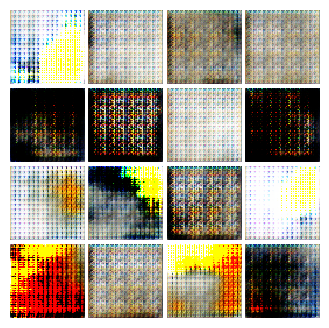


EPOCH:  170
EPOCH:  171
EPOCH:  172
Iter: 14750, D: 0.2882, G:0.09573


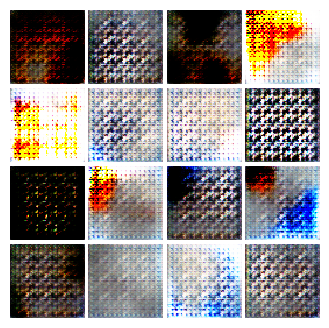


EPOCH:  173
EPOCH:  174
EPOCH:  175
Iter: 15000, D: 0.3537, G:0.08332


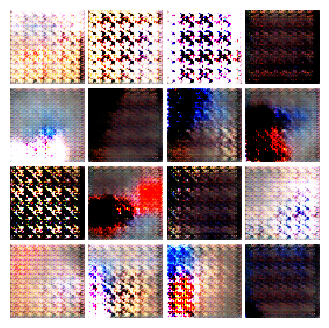


EPOCH:  176
EPOCH:  177
EPOCH:  178
Iter: 15250, D: 0.2274, G:0.1809


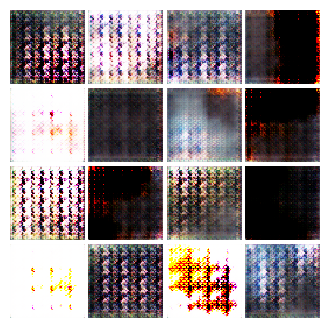


EPOCH:  179
EPOCH:  180
EPOCH:  181
Iter: 15500, D: 0.2175, G:0.1306


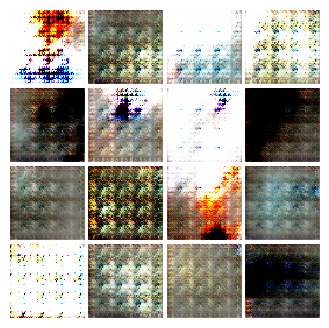


EPOCH:  182
EPOCH:  183
EPOCH:  184
Iter: 15750, D: 0.2321, G:0.1575


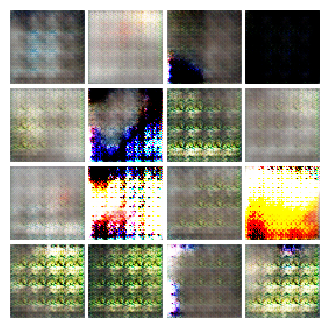


EPOCH:  185
EPOCH:  186
EPOCH:  187
Iter: 16000, D: 0.2335, G:0.1113


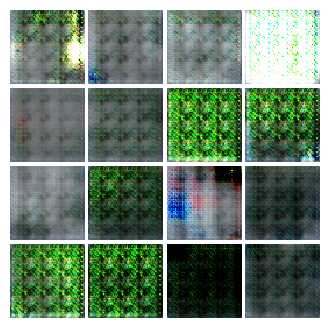


EPOCH:  188
EPOCH:  189
Iter: 16250, D: 0.2918, G:0.3301


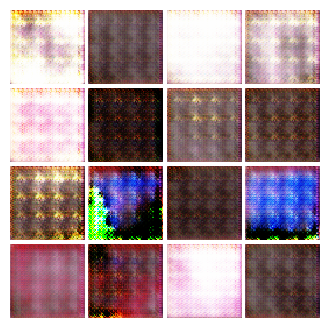


EPOCH:  190
EPOCH:  191
EPOCH:  192
Iter: 16500, D: 0.2181, G:0.1635


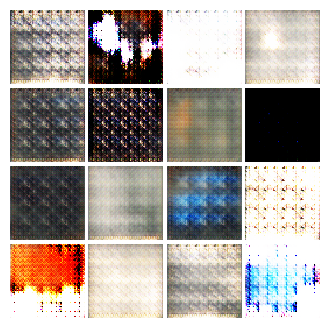


EPOCH:  193
EPOCH:  194
EPOCH:  195
Iter: 16750, D: 0.2163, G:0.1661


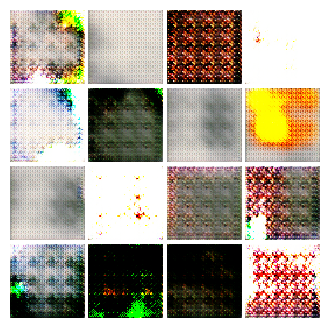


EPOCH:  196
EPOCH:  197
EPOCH:  198
Iter: 17000, D: 0.1846, G:0.2505


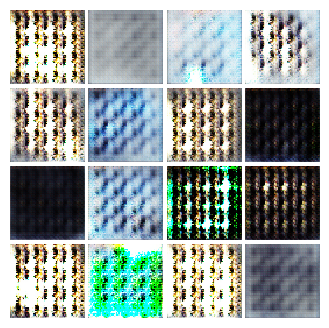


EPOCH:  199
EPOCH:  200
EPOCH:  201
Iter: 17250, D: 0.1008, G:0.4088


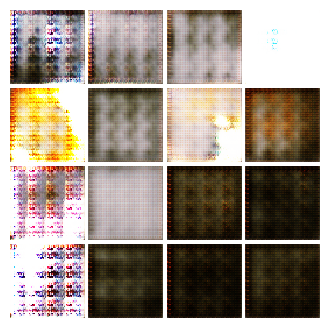


EPOCH:  202
EPOCH:  203
EPOCH:  204
Iter: 17500, D: 0.2469, G:0.4271


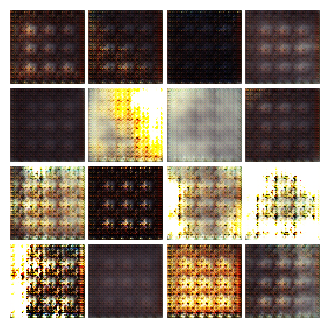


EPOCH:  205
EPOCH:  206
EPOCH:  207
Iter: 17750, D: 0.2545, G:0.5682


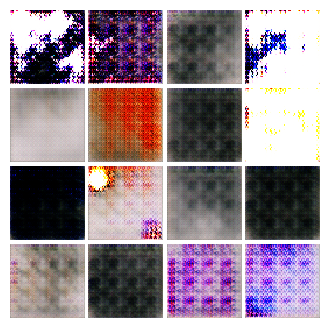


EPOCH:  208
EPOCH:  209
EPOCH:  210
Iter: 18000, D: 0.137, G:0.5161


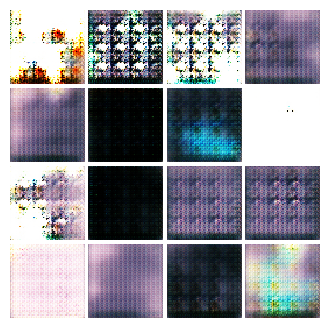


EPOCH:  211
EPOCH:  212
EPOCH:  213
Iter: 18250, D: 0.2527, G:0.2725


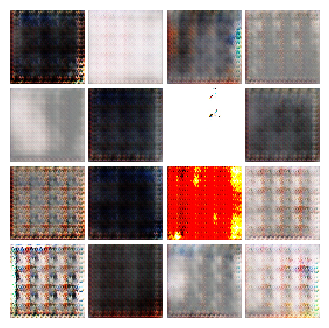


EPOCH:  214
EPOCH:  215
EPOCH:  216
Iter: 18500, D: 0.3117, G:0.3579


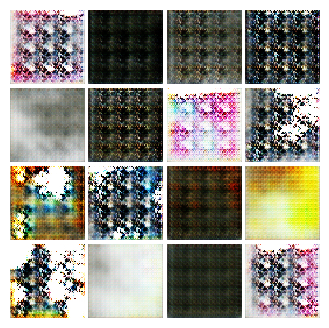


EPOCH:  217
EPOCH:  218
EPOCH:  219
Iter: 18750, D: 0.1299, G:0.4187


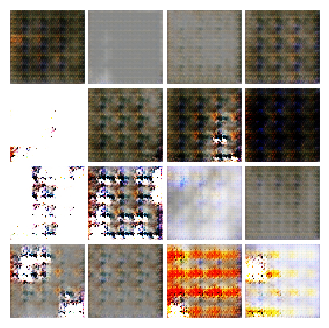


EPOCH:  220
EPOCH:  221
Iter: 19000, D: 0.2266, G:0.298


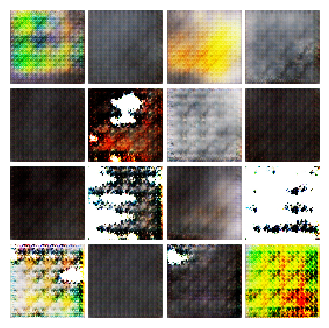


EPOCH:  222
EPOCH:  223
EPOCH:  224
Iter: 19250, D: 0.1199, G:0.4219


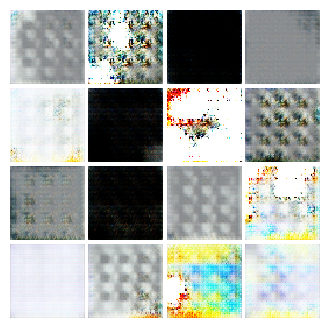


EPOCH:  225
EPOCH:  226
EPOCH:  227
Iter: 19500, D: 0.2171, G:0.2032


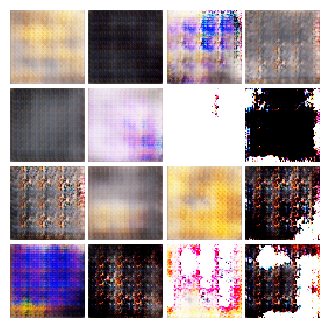


EPOCH:  228
EPOCH:  229
EPOCH:  230
Iter: 19750, D: 0.1681, G:0.1837


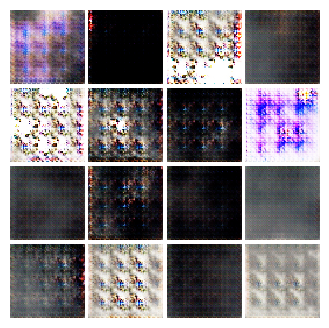


EPOCH:  231
EPOCH:  232
EPOCH:  233
Iter: 20000, D: 0.2134, G:0.6622


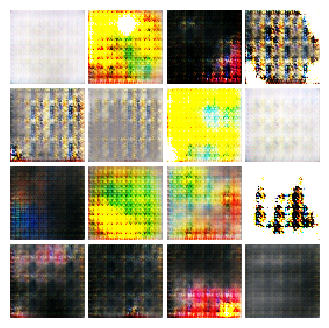


EPOCH:  234
EPOCH:  235
EPOCH:  236
Iter: 20250, D: 0.16, G:0.1159


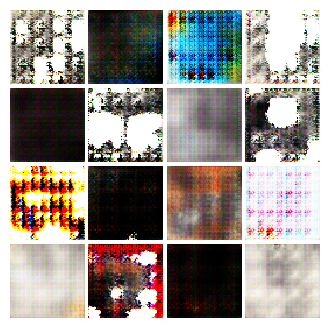


EPOCH:  237
EPOCH:  238
EPOCH:  239
Iter: 20500, D: 0.278, G:0.3646


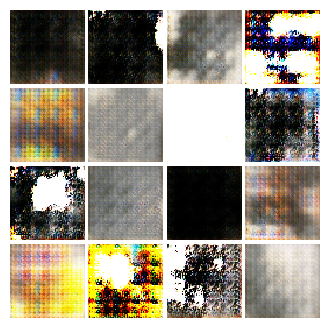


EPOCH:  240
EPOCH:  241
EPOCH:  242
Iter: 20750, D: 0.1123, G:0.4144


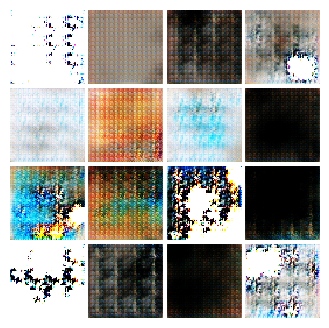


EPOCH:  243
EPOCH:  244
EPOCH:  245
Iter: 21000, D: 0.1567, G:0.4025


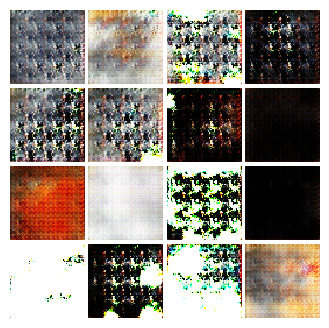


EPOCH:  246
EPOCH:  247
EPOCH:  248
Iter: 21250, D: 0.05802, G:0.347


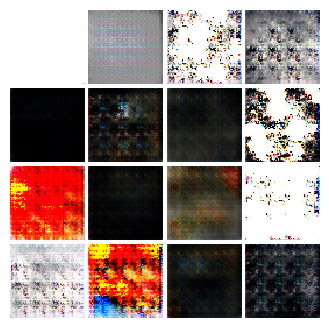


EPOCH:  249
EPOCH:  250
EPOCH:  251
Iter: 21500, D: 0.1221, G:0.1877


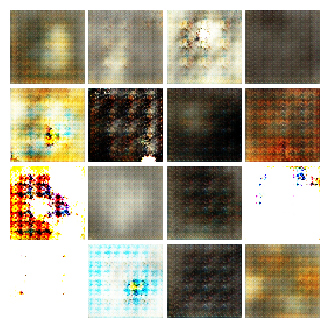


EPOCH:  252
EPOCH:  253
Iter: 21750, D: 0.1848, G:0.3748


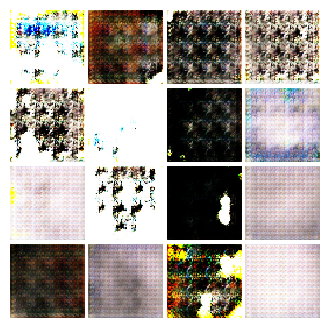


EPOCH:  254
EPOCH:  255
EPOCH:  256
Iter: 22000, D: 0.1618, G:0.5719


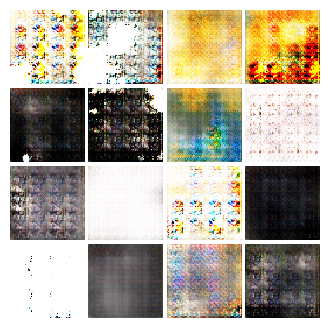


EPOCH:  257
EPOCH:  258
EPOCH:  259
Iter: 22250, D: 0.3019, G:0.1465


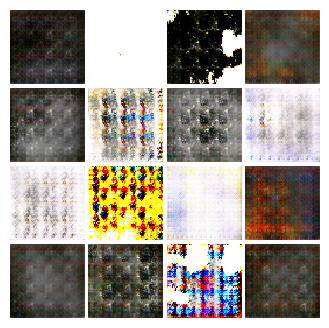


EPOCH:  260
EPOCH:  261
EPOCH:  262
Iter: 22500, D: 0.2344, G:0.3674


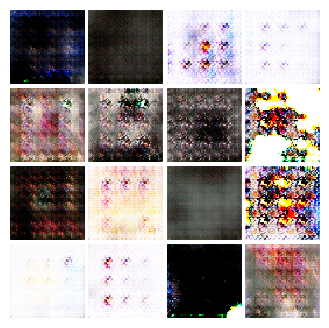


EPOCH:  263
EPOCH:  264
EPOCH:  265
Iter: 22750, D: 0.148, G:0.1834


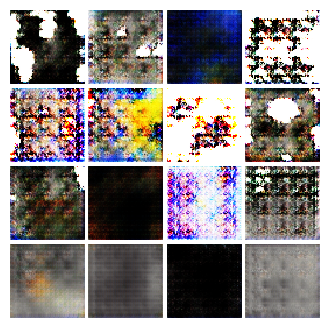


EPOCH:  266
EPOCH:  267
EPOCH:  268
Iter: 23000, D: 0.1913, G:0.471


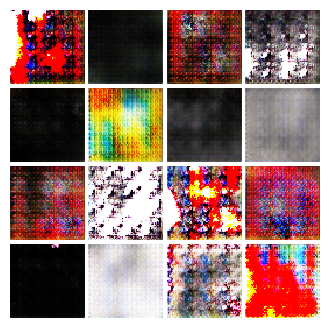


EPOCH:  269
EPOCH:  270
EPOCH:  271
Iter: 23250, D: 0.1001, G:0.3004


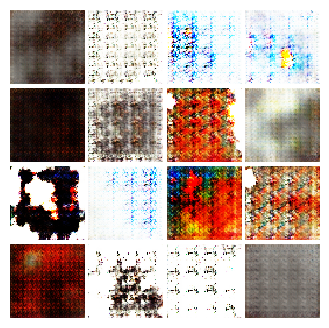


EPOCH:  272
EPOCH:  273
EPOCH:  274
Iter: 23500, D: 0.1242, G:0.2089


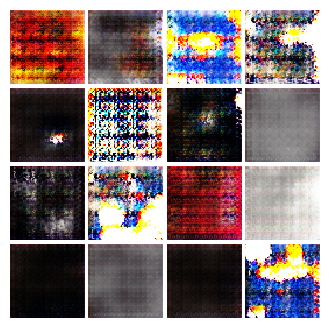


EPOCH:  275
EPOCH:  276
EPOCH:  277
Iter: 23750, D: 0.2981, G:0.5128


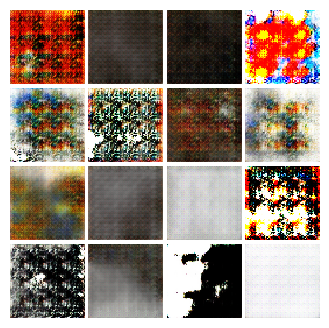


EPOCH:  278
EPOCH:  279
EPOCH:  280
Iter: 24000, D: 0.1269, G:0.6447


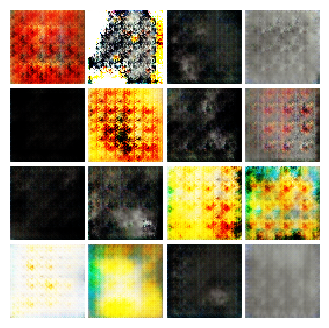


EPOCH:  281
EPOCH:  282
Iter: 24250, D: 0.2853, G:0.3332


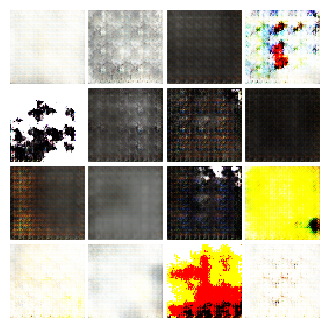


EPOCH:  283
EPOCH:  284
EPOCH:  285
Iter: 24500, D: 0.1405, G:0.4487


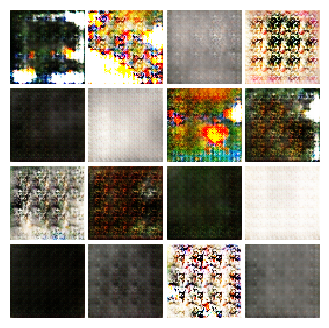


EPOCH:  286
EPOCH:  287
EPOCH:  288
Iter: 24750, D: 0.2896, G:0.8368


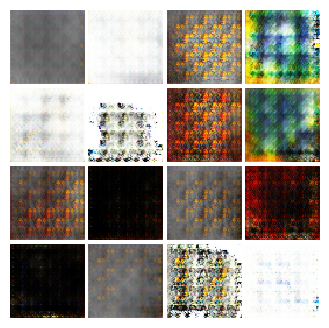


EPOCH:  289
EPOCH:  290
EPOCH:  291
Iter: 25000, D: 0.07075, G:0.6711


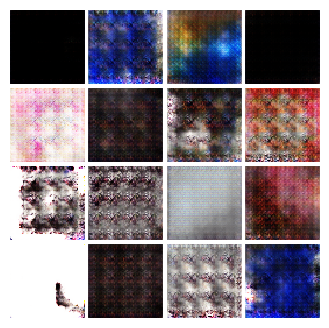


EPOCH:  292
EPOCH:  293
EPOCH:  294
Iter: 25250, D: 0.1132, G:0.7276


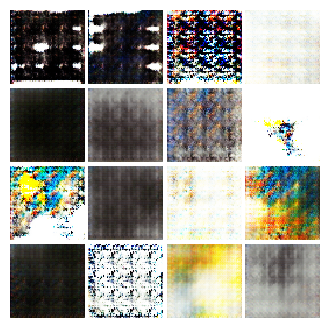


EPOCH:  295
EPOCH:  296
EPOCH:  297
Iter: 25500, D: 0.1321, G:0.2951


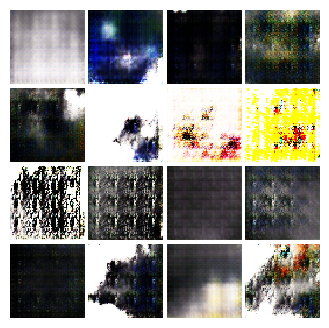


EPOCH:  298
EPOCH:  299
EPOCH:  300


In [ ]:
# ls-gan
train(D, G, D_optimizer, G_optimizer, ls_discriminator_loss, 
          ls_generator_loss, num_epochs=NUM_EPOCHS, show_every=250,
          batch_size=batch_size, train_loader=abstract_loader_train, device=device)